# Global Food Security and Agricultural Productivity Trends: A Data-Driven Analysis Using FAOSTAT and Climate Data

## Data Import & Libraries
In this section, we:
- Import necessary libraries (Pandas, NumPy, Plotly, etc.)
- Load  merged dataset from FAOSTAT and climate sources


In [44]:
import os
import pandas as pd 
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from scipy import stats

In [45]:
current_dir = os.getcwd()
dataset_path= os.path.join(current_dir, 'Cleaned_dataset.csv') 
population_path = os.path.join(current_dir, 'Population dataset.xslx')

In [46]:
df = pd.read_csv(dataset_path)
df

,Country,Item,Element,Year,Value,Unit,TotalRainfall_mm,AvgTemp_C
0,Afghanistan,"Almonds, in shell",Area harvested,1990,6037.00,ha,5306.200033,13.336816
1,Afghanistan,"Almonds, in shell",Yield,1990,1573.60,kg/ha,5306.200033,13.336816
2,Afghanistan,"Almonds, in shell",Production,1990,9500.00,t,5306.200033,13.336816
3,Afghanistan,"Anise, badian, coriander, cumin, caraway, fenn...",Area harvested,1990,1300.00,ha,5306.200033,13.336816
4,Afghanistan,"Anise, badian, coriander, cumin, caraway, fenn...",Yield,1990,769.20,kg/ha,5306.200033,13.336816
...,...,...,...,...,...,...,...,...
2249375,Net Food Importing Developing Countries (NFIDCs),"Treenuts, Total",Yield,2022,676.60,kg/ha,NaN,NaN
2249376,Net Food Importing Developing Countries (NFIDCs),"Treenuts, Total",Production,2022,2854981.94,t,NaN,NaN
2249377,Net Food Importing Developing Countries (NFIDCs),Vegetables Primary,Area harvested,2022,7754677.00,ha,NaN,NaN
2249378,Net Food Importing Developing Countries (NFIDCs),Vegetables Primary,Yield,2022,12442.00,kg/ha,NaN,NaN


 ## Data Cleaning & Preparation
 Here, we:
-Dropped  missing valuems)
- Create a `Category` column for grouping (e.g., cereals, oilseeds, etc.)


In [47]:
df = df.dropna()

In [48]:
item_to_category = {
    # Fruits
    'Apples': 'Fruits', 'Apricots': 'Fruits', 'Bananas': 'Fruits',
    'Cantaloupes and other melons': 'Fruits', 'Figs': 'Fruits',
    'Grapes': 'Fruits', 'Lemons and limes': 'Fruits', 'Mangoes, guavas and mangosteens': 'Fruits',
    'Oranges': 'Fruits', 'Papayas': 'Fruits', 'Peaches and nectarines': 'Fruits',
    'Pears': 'Fruits', 'Pineapples': 'Fruits', 'Plums and sloes': 'Fruits',
    'Plantains and cooking bananas': 'Fruits', 'Strawberries': 'Fruits', 'Watermelons': 'Fruits',
    'Avocados': 'Fruits', 'Kiwi fruit': 'Fruits', 'Raspberries': 'Fruits', 'Blueberries': 'Fruits',
    'Cranberries': 'Fruits', 'Quinces': 'Fruits', 'Tangerines, mandarins, clementines': 'Fruits',
    'Pomelos and grapefruits': 'Fruits', 'Other citrus fruit, n.e.c.': 'Fruits',
    'Other tropical fruits, n.e.c.': 'Fruits', 'Other fruits, n.e.c.': 'Fruits',

    # Vegetables
    'Cabbages': 'Vegetables', 'Carrots and turnips': 'Vegetables',
    'Cauliflowers and broccoli': 'Vegetables', 'Chillies and peppers, green (Capsicum spp. and Pimenta spp.)': 'Vegetables',
    'Chillies and peppers, dry (Capsicum spp., Pimenta spp.), raw': 'Vegetables',
    'Cucumbers and gherkins': 'Vegetables', 'Eggplants (aubergines)': 'Vegetables',
    'Garlic': 'Vegetables', 'Leeks and other alliaceous vegetables': 'Vegetables',
    'Okra': 'Vegetables', 'Onions and shallots, dry (excluding dehydrated)': 'Vegetables',
    'Onions and shallots, green': 'Vegetables', 'Pumpkins, squash and gourds': 'Vegetables',
    'Spinach': 'Vegetables', 'Tomatoes': 'Vegetables', 'Mushrooms and truffles': 'Vegetables',
    'String beans': 'Vegetables', 'Cassava leaves': 'Vegetables',
    'Asparagus': 'Vegetables', 'Lettuce and chicory': 'Vegetables',
    'Other vegetables, fresh n.e.c.': 'Vegetables',

    # Cereals / Grains
    'Barley': 'Cereals', 'Maize (corn)': 'Cereals', 'Millet': 'Cereals',
    'Oats': 'Cereals', 'Rice': 'Cereals', 'Rye': 'Cereals', 'Sorghum': 'Cereals',
    'Wheat': 'Cereals', 'Triticale': 'Cereals', 'Fonio': 'Cereals',
    'Mixed grain': 'Cereals', 'Cereals, primary': 'Cereals', 'Cereals n.e.c.': 'Cereals',

    # Oil Seeds
    'Linseed': 'Oil Seeds', 'Sesame seed': 'Oil Seeds', 'Sunflower seed': 'Oil Seeds',
    'Groundnuts, excluding shelled': 'Oil Seeds', 'Soya beans': 'Oil Seeds',
    'Rape or colza seed': 'Oil Seeds', 'Safflower seed': 'Oil Seeds', 'Oil palm fruit': 'Oil Seeds',
    'Palm kernels': 'Oil Seeds', 'Coconuts, in shell': 'Oil Seeds', 'Mustard seed': 'Oil Seeds',
    'Cotton seed': 'Oil Seeds', 'Other oil seeds, n.e.c.': 'Oil Seeds', 'Hempseed': 'Oil Seeds',
    'Melonseed': 'Oil Seeds', 'Tung nuts': 'Oil Seeds', 'Tallowtree seeds': 'Oil Seeds',
    'Jojoba seeds': 'Oil Seeds', 'Castor oil seeds': 'Oil Seeds',

    # Roots and Tubers
    'Potatoes': 'Roots and Tubers', 'Cassava, fresh': 'Roots and Tubers',
    'Sweet potatoes': 'Roots and Tubers', 'Yams': 'Roots and Tubers', 'Taro': 'Roots and Tubers',
    'Sugar beet': 'Roots and Tubers', 'Edible roots and tubers with high starch or inulin content, n.e.c., fresh': 'Roots and Tubers',

    # Pulses
    'Beans, dry': 'Pulses', 'Chick peas, dry': 'Pulses', 'Cow peas, dry': 'Pulses',
    'Lentils, dry': 'Pulses', 'Lupins': 'Pulses', 'Peas, dry': 'Pulses',
    'Peas, green': 'Pulses', 'Pigeon peas, dry': 'Pulses', 'Broad beans and horse beans, dry': 'Pulses',
    'Broad beans and horse beans, green': 'Pulses', 'Other pulses n.e.c.': 'Pulses',
    'Bambara beans, dry': 'Pulses', 'Vetches': 'Pulses', 'Other beans, green': 'Pulses',

    # Nuts
    'Almonds, in shell': 'Nuts', 'Walnuts, in shell': 'Nuts',
    'Pistachios, in shell': 'Nuts', 'Cashew nuts, in shell': 'Nuts', 'Hazelnuts, in shell': 'Nuts',
    'Brazil nuts, in shell': 'Nuts', 'Chestnuts, in shell': 'Nuts', 'Areca nuts': 'Nuts',
    'Kola nuts': 'Nuts', 'Other nuts (excluding wild edible nuts and groundnuts), in shell, n.e.c.': 'Nuts',

    # Livestock
    'Cattle': 'Livestock', 'Goats': 'Livestock', 'Sheep': 'Livestock',
    'Camels': 'Livestock', 'Horses': 'Livestock', 'Buffalo': 'Livestock',
    'Mules and hinnies': 'Livestock', 'Asses': 'Livestock', 'Poultry Birds': 'Livestock',
    'Chickens': 'Livestock', 'Ducks': 'Livestock', 'Geese': 'Livestock',
    'Rabbits and hares': 'Livestock', 'Other rodents': 'Livestock', 'Other camelids': 'Livestock',

    # Meat
    'Meat of cattle with the bone, fresh or chilled': 'Meat',
    'Meat of sheep, fresh or chilled': 'Meat',
    'Meat of goats, fresh or chilled': 'Meat',
    'Meat of chickens, fresh or chilled': 'Meat',
    'Meat of pigs, fresh or chilled': 'Meat',
    'Meat of turkeys, fresh or chilled': 'Meat',
    'Meat of ducks, fresh or chilled': 'Meat',
    'Meat of buffalo, fresh or chilled': 'Meat',
    'Meat of camels, fresh or chilled': 'Meat',
    'Meat of geese, fresh or chilled': 'Meat',
    'Meat of rabbits and hares, fresh or chilled': 'Meat',
    'Meat of other domestic camelids, fresh or chilled': 'Meat',
    'Meat of other domestic rodents, fresh or chilled': 'Meat',
    'Game meat, fresh, chilled or frozen': 'Meat',

    # Dairy
    'Butter of cow milk': 'Dairy', 'Butter of buffalo milk': 'Dairy', 'Butter and Ghee': 'Dairy',
    'Cheese from milk of goats, fresh or processed': 'Dairy',
    'Cheese from milk of sheep, fresh or processed': 'Dairy',
    'Cheese from whole cow milk': 'Dairy',
    'Cheese (All Kinds)': 'Dairy',
    'Cream, fresh': 'Dairy', 'Ghee from cow milk': 'Dairy',
    'Raw milk of cattle': 'Dairy', 'Raw milk of goats': 'Dairy',
    'Raw milk of sheep': 'Dairy', 'Raw milk of buffalo': 'Dairy',
    'Skim milk, condensed': 'Dairy', 'Skim milk and whey powder': 'Dairy',
    'Yoghurt': 'Dairy', 'Whole milk, condensed': 'Dairy',
    'Skim milk of cows': 'Dairy', 'Evaporated & Condensed Milk': 'Dairy',
    'Whole milk powder': 'Dairy',

    # Sweeteners
    'Sugar cane': 'Sweeteners', 'Molasses': 'Sweeteners',
    'Raw cane or beet sugar (centrifugal only)': 'Sweeteners',
    'Honey': 'Sweeteners', 'Sugar Crops Primary': 'Sweeteners',
    'Other sugar crops n.e.c.': 'Sweeteners',

    # Beverage Crops
    'Coffee, green': 'Beverage Crops', 'Tea leaves': 'Beverage Crops',
    'Wine': 'Beverage Crops', 'Beer of barley, malted': 'Beverage Crops',

    # Spices
    'Anise, badian, coriander, cumin, caraway, fennel and juniper berries, raw': 'Spices',
    'Pepper (Piper spp.), raw': 'Spices', 'Cloves (whole stems), raw': 'Spices',
    'Cinnamon and cinnamon-tree flowers, raw': 'Spices',
    'Nutmeg, mace, cardamoms, raw': 'Spices', 'Ginger, raw': 'Spices',
    'Peppermint, spearmint': 'Spices', 'Other stimulant, spice and aromatic crops, n.e.c.': 'Spices',

    # Fibres
    'Cotton lint, ginned': 'Fibres', 'Jute, raw or retted': 'Fibres',
    'Sisal, raw': 'Fibres', 'Ramie, raw or retted': 'Fibres',
    'Flax, raw or retted': 'Fibres', 'Hempseed': 'Fibres',
    'Other fibre crops, raw, n.e.c.': 'Fibres', 'True hemp, raw or retted': 'Fibres',
    'Kenaf, and other textile bast fibres, raw or retted': 'Fibres',
    'Kapok fibre, raw': 'Fibres', 'Agave fibres, raw, n.e.c.': 'Fibres',
    'Coir, raw': 'Fibres', 'Abaca, manila hemp, raw': 'Fibres',
}
item_to_category.update({
    # Oils
    'Cottonseed oil': 'Oils and Fats',
    'Oil of linseed': 'Oils and Fats',
    'Oil of sesame seed': 'Oils and Fats',
    'Olive oil': 'Oils and Fats',
    'Sunflower-seed oil, crude': 'Oils and Fats',
    'Soya bean oil': 'Oils and Fats',
    'Groundnut oil': 'Oils and Fats',
    'Rapeseed or canola oil, crude': 'Oils and Fats',
    'Safflower-seed oil, crude': 'Oils and Fats',
    'Oil of palm kernel': 'Oils and Fats',
    'Palm oil': 'Oils and Fats',
    'Oil of maize': 'Oils and Fats',
    'Coconut oil': 'Oils and Fats',
    'Tallow': 'Oils and Fats',
    'Margarine and shortening': 'Oils and Fats',

    # Fruits
    'Olives': 'Fruits',
    'Cherries': 'Fruits',
    'Sour cherries': 'Fruits',
    'Currants': 'Fruits',
    'Persimmons': 'Fruits',
    'Gooseberries': 'Fruits',
    'Cashewapple': 'Fruits',
    'Other berries and fruits of the genus vaccinium n.e.c.': 'Fruits',
    'Other stone fruits': 'Fruits',
    'Other pome fruits': 'Fruits',
    'Fruit Primary': 'Fruits',
    'Citrus Fruit, Total': 'Fruits',
    'Dates': 'Fruits',

    # Vegetables
    'Artichokes': 'Vegetables',
    'Green garlic': 'Vegetables',
    'Vegetables Primary': 'Vegetables',

    # Pulses / Legumes
    'Pulses, Total': 'Pulses',

    # Roots & Tubers
    'Roots and Tubers, Total': 'Roots and Tubers',
    'Yautia': 'Roots and Tubers',
    'Chicory roots': 'Roots and Tubers',

    # Tree Nuts
    'Treenuts, Total': 'Nuts',
    'Karite nuts (sheanuts)': 'Nuts',

    # Fibre Crops
    'Fibre Crops, Fibre Equivalent': 'Fibres',
    'Kapok fruit': 'Fibres',
    'Kapokseed in shell': 'Fibres',

    # Silk & Related
    'Raw silk (not thrown)': 'Animal Products',
    'Silk-worm cocoons suitable for reeling': 'Animal Products',

    # Other Crops
    'Seed cotton, unginned': 'Industrial Crops',
    'Cocoa beans': 'Beverage Crops',
    'Maté leaves': 'Beverage Crops',
    'Green tea (not fermented), black tea (fermented) and partly fermented tea, in immediate packings of a content not exceeding 3 kg': 'Beverage Crops',
    'Hop cones': 'Beverage Crops',

    # Spices & Aromatics
    'Vanilla, raw': 'Spices and Aromatics',
    'Pyrethrum, dried flowers': 'Spices and Aromatics',

    # Oilcrops Grouped
    'Oilcrops, Cake Equivalent': 'Oil Seeds',
    'Oilcrops, Oil Equivalent': 'Oil Seeds',

    # Other
    'Bees': 'Animal Products',
    'Beeswax': 'Animal Products',
    'Swine / pigs': 'Livestock',
    'Turkeys': 'Livestock',
    'Unmanufactured tobacco': 'Industrial Crops',
    'Locust beans (carobs)': 'Pulses',
    'Canary seed': 'Cereals',
    'Buckwheat': 'Cereals',
    'Poppy seed': 'Oil Seeds',
    'Quinoa': 'Cereals',
    'Natural honey': 'Sweeteners',
    'Natural rubber in primary forms': 'Industrial Crops',
    'Balata, gutta-percha, guayule, chicle and similar natural gums in primary forms or in plates, sheets or strip': 'Industrial Crops',
    'Other birds': 'Livestock',
    'Green corn (maize)': 'Cereals'

})

# Apply the mapping to create a new column
df['Category'] = df['Item'].map(item_to_category)

# # Fill any missing values as 'Uncategorized' so you can review and classify them later
# df_crop_only['Category'] = df_crop_only['Category'].fillna('Uncategorized')
# df_crop_only
df

C:\Users\User\AppData\Local\Temp\ipykernel_17680\3768204602.py:217: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Country,Item,Element,Year,Value,Unit,TotalRainfall_mm,AvgTemp_C,Category
0,Afghanistan,"Almonds, in shell",Area harvested,1990,6037.00,ha,5306.200033,13.336816,Nuts
1,Afghanistan,"Almonds, in shell",Yield,1990,1573.60,kg/ha,5306.200033,13.336816,Nuts
2,Afghanistan,"Almonds, in shell",Production,1990,9500.00,t,5306.200033,13.336816,Nuts
3,Afghanistan,"Anise, badian, coriander, cumin, caraway, fenn...",Area harvested,1990,1300.00,ha,5306.200033,13.336816,Spices
4,Afghanistan,"Anise, badian, coriander, cumin, caraway, fenn...",Yield,1990,769.20,kg/ha,5306.200033,13.336816,Spices
...,...,...,...,...,...,...,...,...,...
2023428,Zimbabwe,"Treenuts, Total",Yield,2019,6231.40,kg/ha,5633.200000,22.287533,Nuts
2023429,Zimbabwe,"Treenuts, Total",Production,2019,59403.44,t,5633.200000,22.287533,Nuts
2023430,Zimbabwe,Vegetables Primary,Area harvested,2019,84175.00,ha,5633.200000,22.287533,Vegetables
2023431,Zimbabwe,Vegetables Primary,Yield,2019,21133.40,kg/ha,5633.200000,22.287533,Vegetables


In [49]:
uncategorized_items = df[df['Category'] == 'Uncategorized']['Item'].unique()
print("Uncategorized Items:\n", uncategorized_items)

Uncategorized Items:
 []


## EXPLORATORY DESCRIPTIVE ANALYSIS

This section includes:

- Generating summary statistics to understand central tendencies and variability across variables  
- Visualizing global crop production trends  
- Comparing crop production across categories  
- Identifying top-producing countries
lots


### Summary statistics

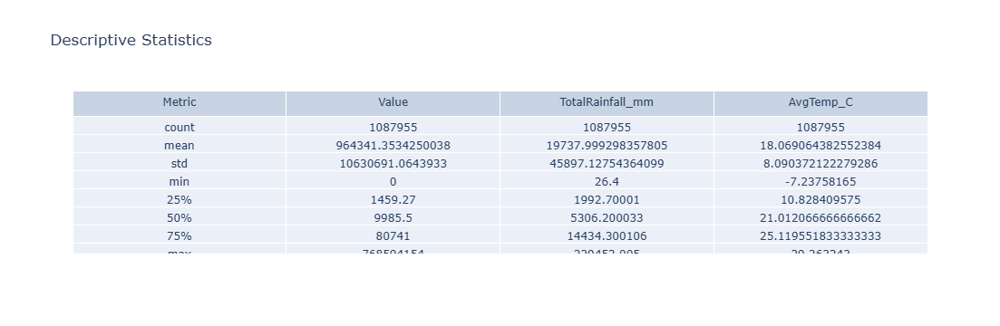

In [50]:
# Summary stats for numerical variables
summary_stats = df[['Value', 'TotalRainfall_mm', 'AvgTemp_C']].describe().reset_index()
fig = go.Figure(data=[go.Table(
    header=dict(values=['Metric'] + summary_stats.columns[1:].tolist()),
    cells=dict(values=[summary_stats['index']] + [summary_stats[col] for col in summary_stats.columns[1:]])
)])
# fig.update_traces(marker_color='#006400')
fig.update_layout(title='Descriptive Statistics')
fig.show()

In [51]:
{
    "Unique Countries": df['Country'].nunique(),
    "Unique Items": df['Item'].nunique(),
    "Unique Categories": df['Category'].nunique()
}


{'Unique Countries': 131, 'Unique Items': 301, 'Unique Categories': 18}

In [52]:
df['Country'] = df['Country'].replace({ 'Congo': 'DRC' })

C:\Users\User\AppData\Local\Temp\ipykernel_17680\2696075300.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Global Crop Production Across Years

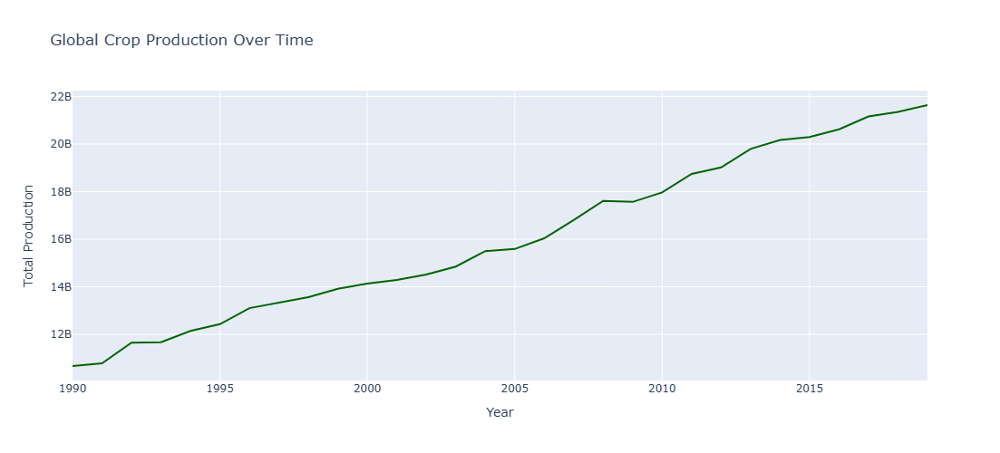

In [53]:
production_df = df[df['Element'] == 'Production']
yearly_production = production_df.groupby('Year')['Value'].sum().reset_index()

fig = px.line(yearly_production, x='Year', y='Value', title='Global Crop Production Over Time')
fig.update_layout(yaxis_title='Total Production', height = 500)
fig.update_traces(line=dict(color='#006400'))
fig.show()

### Global Crop Production Accross Categories

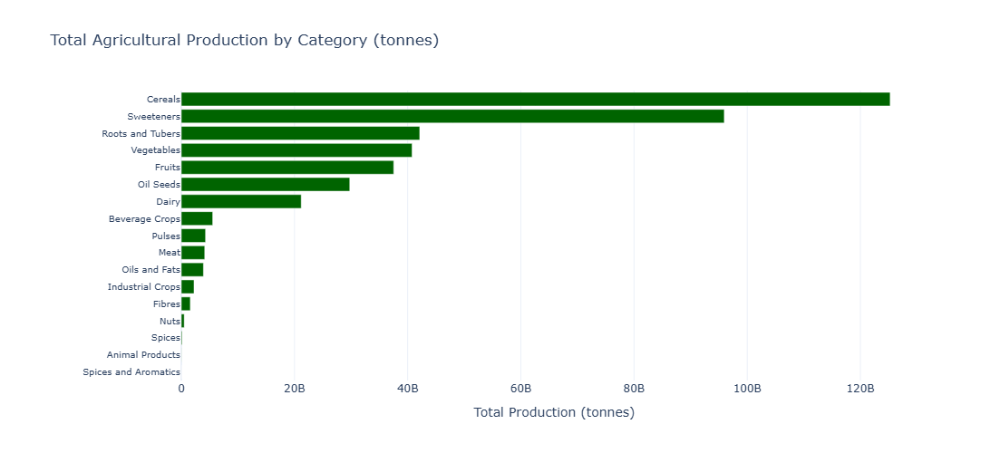

In [54]:
production_data = df[df['Element'] == 'Production']

# Sum production by category
category_production = production_data.groupby('Category')['Value'].sum().reset_index().sort_values(by='Value', ascending=True)

# Create horizontal bar chart
fig = px.bar(
    category_production,
    y='Category',          # Category on Y-axis
    x='Value',             # Production value on X-axis
    orientation='h',       # Horizontal orientation
    title='Total Agricultural Production by Category (tonnes)',
    labels={'Value': 'Total Production (tonnes)'}  # Clear axis label
)

fig.update_layout(
    height=500,
    yaxis=dict(
        tickfont=dict(size=10),
        categoryorder='total ascending'  # Sort categories by production
    ),
    margin=dict(l=200),  # Left margin for long category names
    xaxis_title='Total Production (tonnes)',
    yaxis_title='',
    template='plotly_white',
    hovermode='y unified'  # Better hover labels
)

fig.update_traces(
    marker_color='#006400',  # Dark green for agriculture theme
    hovertemplate='%{x:,.0f} tonnes'  # Format hover text
)

fig.show()

### Global Crop Production Accross Countries

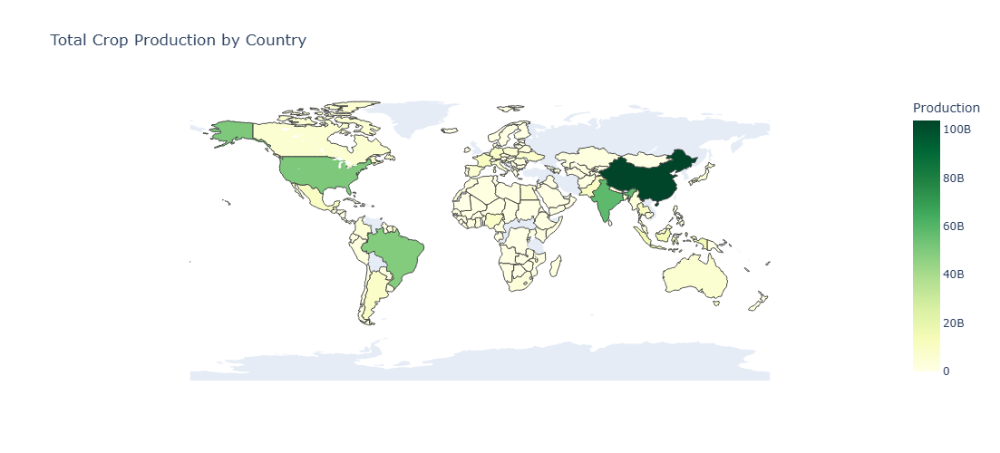

In [55]:
# Filter for Production
production_df = df[df['Element'] == 'Production']

# Group by Country to get total production
country_production = production_df.groupby('Country')['Value'].sum().reset_index()

# Create choropleth map
fig = px.choropleth(
    country_production,
    locations='Country',
    locationmode='country names',
    color='Value',
    color_continuous_scale='YlGn',
    title='Total Crop Production by Country',
)

fig.update_layout(
    geo=dict(showframe=False, showcoastlines=False),
    coloraxis_colorbar=dict(title="Production"), height = 500
)

fig.show()


### Top produced Cereal items

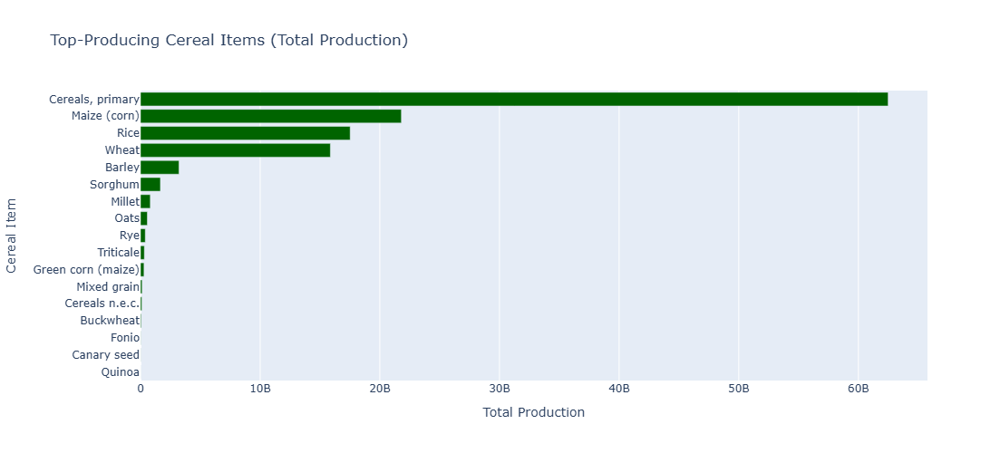

In [56]:
# Filter to only include Cereals and Production element
cereals_df = df[
    (df['Category'] == 'Cereals') & 
    (df['Element'] == 'Production')
]

# Group by Item and sum production values
cereal_items_total = cereals_df.groupby('Item')['Value'].sum().reset_index()
cereal_items_total = cereal_items_total.sort_values(by='Value', ascending=False)

# Plot horizontal bar chart
fig = px.bar(
    cereal_items_total, 
    x='Value', 
    y='Item', 
    orientation='h',
    title='Top-Producing Cereal Items (Total Production)',
    labels={'Value': 'Total Production', 'Item': 'Cereal Item'}
)
fig.update_traces(marker_color='#006400')
fig.update_layout(yaxis=dict(categoryorder='total ascending'), height= 500)  # Sort y-axis
fig.show()

### Crop Production Accross East Countries

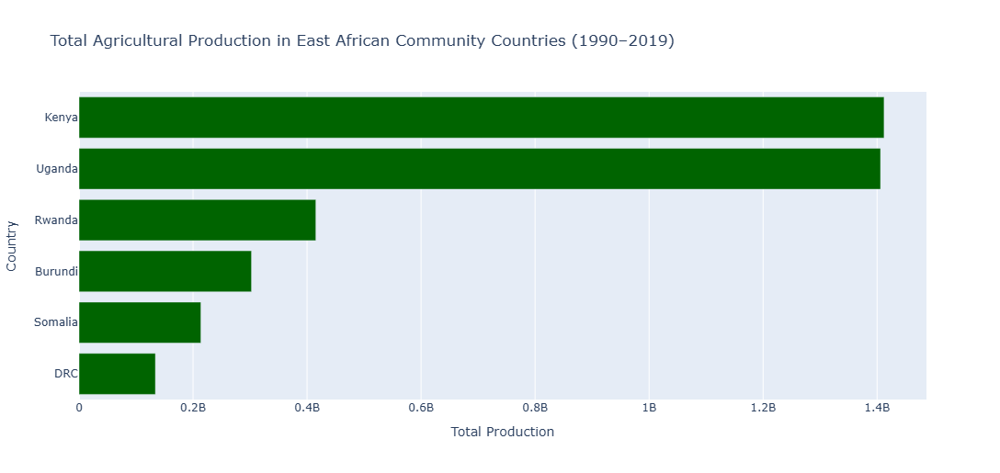

In [59]:
# Define EAC (East African Community) member countries
eac_countries = [
    'Burundi', 'DRC', 'Kenya',
    'Rwanda', 'South Sudan', 'Tanzania', 'Uganda', 'Somalia'
]

# Filter for EAC countries and Production element
eac_df = df[
    (df['Country'].isin(eac_countries)) &
    (df['Element'] == 'Production')
]

# Group by country and sum production values
country_production = eac_df.groupby('Country')['Value'].sum().reset_index()
country_production = country_production.sort_values(by='Value', ascending=False)

# Create bar chart using Plotly (single dark green color)
fig = px.bar(
    country_production,
    x='Value',
    y='Country',
    orientation='h',
    title='Total Agricultural Production in East African Community Countries (1990–2019)',
    labels={'Value': 'Total Production', 'Country': 'Country'}
)

# Apply single dark green color to all bars
fig.update_traces(marker_color='darkgreen')

# Update layout
fig.update_layout(yaxis={'categoryorder': 'total ascending'}, height = 500)
fig.show()

### Crop Production Accross Categories in East Africa Community Countries

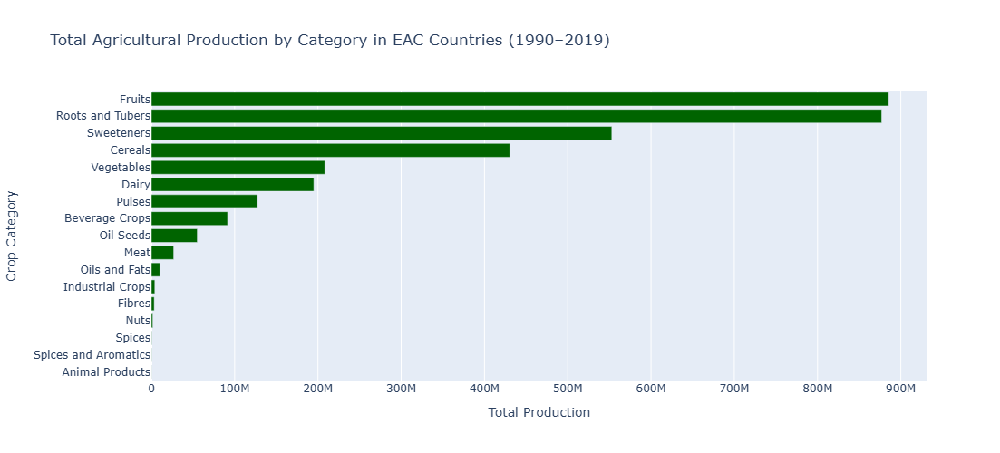

In [74]:

# Define East African Community countries
eac_countries = [
    'Burundi', 'DRC', 'Kenya',
    'Rwanda', 'South Sudan', 'Tanzania', 'Uganda', 'Somalia'
]

# Filter for EAC countries and production element
eac_df = df[
    (df['Country'].isin(eac_countries)) &
    (df['Element'] == 'Production')
]

# Group by Category and sum production values
category_prod = eac_df.groupby('Category')['Value'].sum().reset_index()
category_prod = category_prod.sort_values(by='Value', ascending=True)

# Add a column for fixed color
category_prod['Color'] = 'darkgreen'

# Create horizontal bar chart
fig = px.bar(
    category_prod,
    x='Value',
    y='Category',
    orientation='h',
    title='Total Agricultural Production by Category in EAC Countries (1990–2019)',
    labels={'Value': 'Total Production', 'Category': 'Crop Category'},
    color='Color',  # Use the fixed color column
    color_discrete_map={'darkgreen': 'darkgreen'}  # Apply dark green
)

fig.update_layout(
    showlegend=False,
    yaxis={'categoryorder': 'total ascending'},
    height=500
)

fig.show()


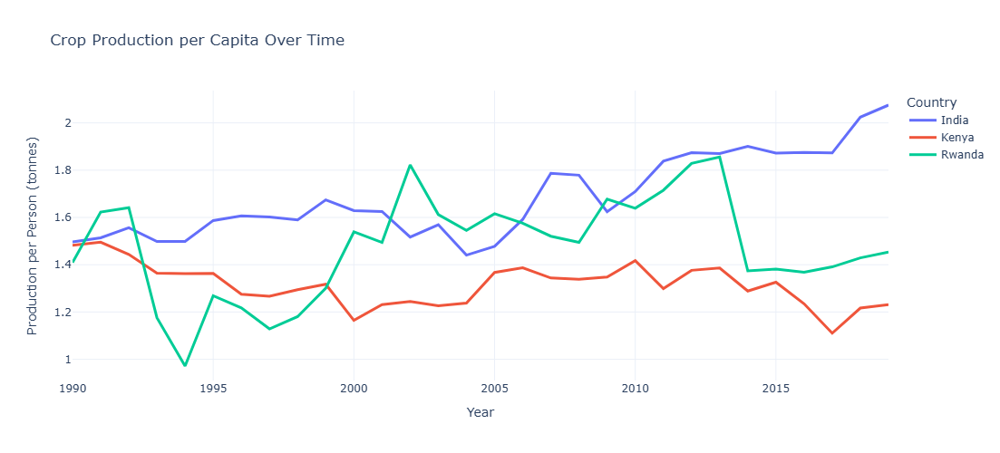

In [82]:
# 3. Calculate production per capita
merged_df['Production_per_Capita'] = merged_df['Total_Production'] / merged_df['Population']

# 4. Plot over time for selected countries (e.g., Kenya, Rwanda, India)
selected_countries = ['Kenya', 'Rwanda', 'India']
filtered_df = merged_df[merged_df['Country'].isin(selected_countries)]

# 5. Line chart
fig = px.line(
    filtered_df,
    x='Year',
    y='Production_per_Capita',
    color='Country',
    title=" Crop Production per Capita Over Time",
    labels={'Production_per_Capita': 'Production per Person (tonnes)'}
)
fig.update_traces(line=dict(width=3))
fig.update_layout(template='plotly_white', height=500)
fig.show()

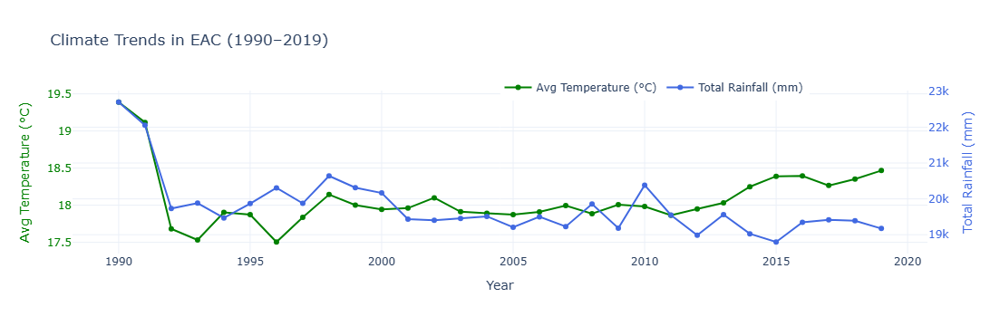

In [83]:
# Filter data from 1990 to 2019
climate_df = df[(df['Year'] >= 1990) & (df['Year'] <= 2019)]

# Group by year and calculate average values
climate_trends = climate_df.groupby('Year')[['AvgTemp_C', 'TotalRainfall_mm']].mean().reset_index()

# Create figure
fig = go.Figure()

# Temperature line (left axis)
fig.add_trace(go.Scatter(
    x=climate_trends['Year'],
    y=climate_trends['AvgTemp_C'],
    name='Avg Temperature (°C)',
    mode='lines+markers',
    line=dict(color='green')
))

# Rainfall line (right axis)
fig.add_trace(go.Scatter(
    x=climate_trends['Year'],
    y=climate_trends['TotalRainfall_mm'],
    name='Total Rainfall (mm)',
    mode='lines+markers',
    line=dict(color='royalblue'),
    yaxis='y2'
))

# Update layout using correct syntax
fig.update_layout(
    title='Climate Trends in EAC (1990–2019)',
    xaxis=dict(title='Year'),
    yaxis=dict(
        title=dict(text='Avg Temperature (°C)', font=dict(color='green')),
        tickfont=dict(color='green')
    ),
    yaxis2=dict(
        title=dict(text='Total Rainfall (mm)', font=dict(color='royalblue')),
        tickfont=dict(color='royalblue'),
        anchor='x',
        overlaying='y',
        side='right'
    ),
    legend=dict(x=0.5, y=1.1, orientation='h'),
    template='plotly_white'
)

fig.show()


In [61]:
# Step 1: Prepare total production data per country per year
prod_df = df[
    df['Element'] == 'Production'
].groupby(['Country', 'Year'])['Value'].sum().reset_index()
prod_df.rename(columns={'Value': 'Total_Production'}, inplace=True)
prod_df

,Country,Year,Total_Production
0,Afghanistan,1990,11646969.08
1,Afghanistan,1991,13598284.64
2,Afghanistan,1992,13043441.76
3,Afghanistan,1993,14388884.64
4,Afghanistan,1994,15247425.65
...,...,...,...
3833,Zimbabwe,2015,19147571.88
3834,Zimbabwe,2016,19444741.24
3835,Zimbabwe,2017,26797126.63
3836,Zimbabwe,2018,26840617.19


In [62]:
pop_df = pd.read_excel(r"C:\Users\User\Documents\climate_data (2)\climate_data\data\processed\Population dataset.xlsx")
pop_df

,Country,Year,Population
0,Africa Eastern and Southern,1990,311748681.0
1,Africa Western and Central,1990,209566031.0
2,Arab World,1990,223184294.0
3,Caribbean small states,1990,2402741.0
4,Central Electricity Board (CEB),1990,110743128.0
...,...,...,...
7945,Virgin Islands (U.S.),2019,106669.0
7946,West Bank and Gaza,2019,4685306.0
7947,"Yemen, Rep.",2019,35111408.0
7948,Zambia,2019,18513839.0


In [63]:
pop_df['Country'] = pop_df['Country'].replace({ 'Congo, Dem. Rep.': 'DRC' })

In [64]:
merged_df = pd.merge(prod_df, pop_df, on=['Country', 'Year'], how='inner')

In [65]:
merged_df

,Country,Year,Total_Production,Population
0,Afghanistan,1990,11646969.08,12045660.0
1,Afghanistan,1991,13598284.64,12238879.0
2,Afghanistan,1992,13043441.76,13278974.0
3,Afghanistan,1993,14388884.64,14943172.0
4,Afghanistan,1994,15247425.65,16250794.0
...,...,...,...,...
3628,Zimbabwe,2015,19147571.88,14399013.0
3629,Zimbabwe,2016,19444741.24,14600294.0
3630,Zimbabwe,2017,26797126.63,14812482.0
3631,Zimbabwe,2018,26840617.19,15034452.0


### Impact Of Population To Production

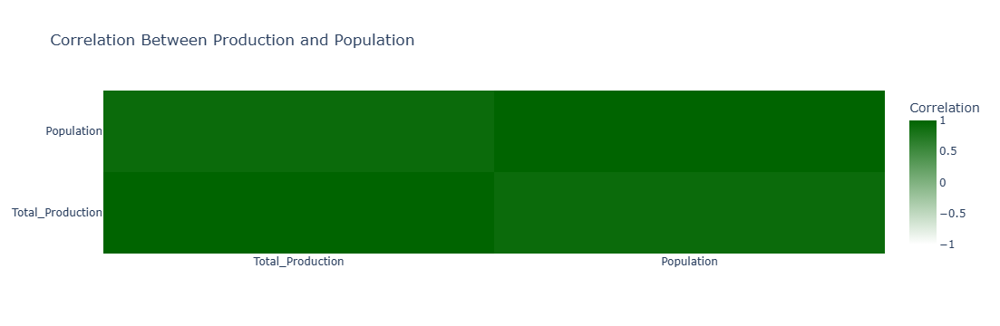

In [66]:
# Step 4: Compute correlation matrix
corr_df = merged_df[['Total_Production', 'Population']].corr()

# Step 5: Plot correlation heatmap
fig = go.Figure(data=go.Heatmap(
    z=corr_df.values,
    x=corr_df.columns,
    y=corr_df.columns,
    colorscale=[[0, 'white'], [1, 'darkgreen']],
    zmin=-1, zmax=1,
    colorbar=dict(title='Correlation')
))
fig.update_layout(title='Correlation Between Production and Population')
fig.show()

## STASTICAL ANALYSIS

F-statistic: 330.18
P-value: 0.0000
✅ Result: Statistically significant difference in production across categories.


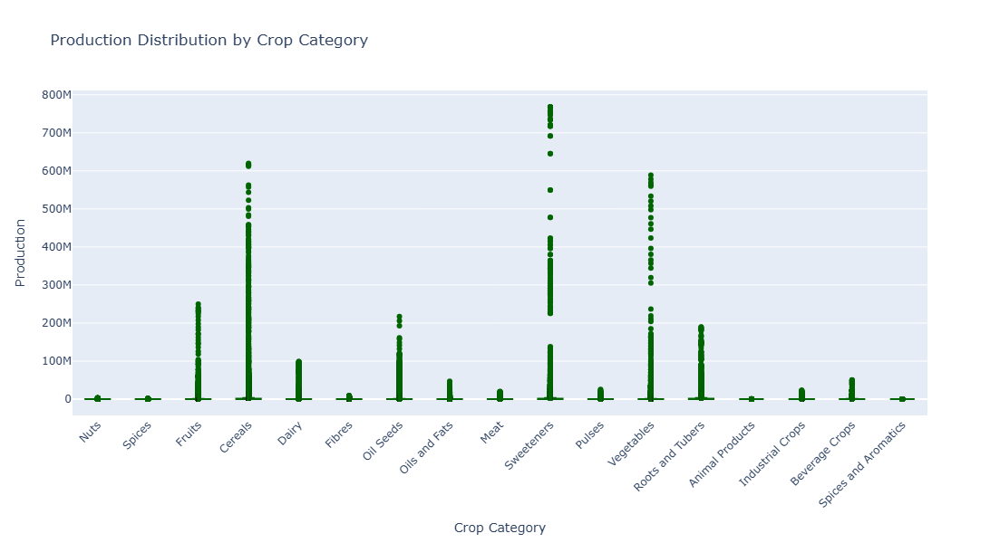

In [68]:
# Filter production data only
prod_df = df[df['Element'] == 'Production'].copy()

# Run One-Way ANOVA: group values per category
grouped_data = [group['Value'].values for _, group in prod_df.groupby('Category')]

f_stat, p_value = stats.f_oneway(*grouped_data)

print(f"F-statistic: {f_stat:.2f}")
print(f"P-value: {p_value:.4f}")

if p_value < 0.05:
    print("✅ Result: Statistically significant difference in production across categories.")
else:
    print("❌ Result: No significant difference in production between crop categories.")

# Optional: Visualize using Plotly box plot
fig = px.box(
    prod_df,
    x="Category",
    y="Value",
    title="Production Distribution by Crop Category",
    labels={"Value": "Production"},
    color_discrete_sequence=["#006400"]
)

fig.update_layout(
    xaxis_title="Crop Category",
    yaxis_title="Production",
    xaxis_tickangle=-45,
    height=600
)

fig.show()


In [69]:
category_mean = prod_df.groupby('Category')['Value'].mean().sort_values(ascending=False)
print(category_mean.head(10))

Category
Sweeteners          6.486065e+06
Cereals             4.507974e+06
Roots and Tubers    2.614537e+06
Oil Seeds           1.081070e+06
Vegetables          9.236444e+05
Dairy               6.583855e+05
Fruits              6.361127e+05
Beverage Crops      5.630556e+05
Industrial Crops    3.935777e+05
Meat                2.166912e+05
Name: Value, dtype: float64
